# This cat does not exist
__Суммарное количество баллов: 10__

Цель этого задания - создать котов, которых не существует. В ходе данного задания вы обучите DCGAN и VAE, которые являются одними из первых генеративных моделей. Для этого задания вам наверняка потребуется GPU с CUDA, поэтому рекомендуется использовать Google Colab.

In [1]:
import torch
from torch import nn
from torch.optim import Adam
from torch.nn import functional as F
from torch.utils.data import Dataset, DataLoader
import os 
import cv2
import matplotlib.pyplot as plt
from tqdm.notebook import tqdm
import random
import numpy as np

%matplotlib inline

In [2]:
def random_noise(batch_size, channels, side_size):
    return torch.randn(batch_size, channels, side_size, side_size).cuda()

In [3]:
def visualise(imgs, rows=2):
    imgs = (imgs.transpose(1, 3) + 1) / 2
    imgs = torch.cat([imgs[i::rows] for i in range(rows)], dim=1)
    cols = len(imgs)
    imgs = (torch.cat(list(imgs), dim=1)).cpu().numpy()[:, :, ::-1]
    plt.figure(figsize=(cols*1.5, rows*1.5))
    plt.imshow(imgs)
    plt.axis('off')
    plt.tight_layout()
    plt.show()

In [4]:
class CatDataset(Dataset):
    def __init__(self, path_to_dataset="cat_136", size=64):
        self.photo_names = os.listdir(path_to_dataset)
        self.path_base = path_to_dataset
        self.size = size
    
    def __getitem__(self, index):
        path = self.path_base + "/" + self.photo_names[index]
        img = cv2.imread(path) # 136 x 136
        crop_rate = 8
        x_crop = random.randint(0, crop_rate)
        y_crop = random.randint(0, crop_rate)
        img = img[x_crop:136 - crop_rate + x_crop, y_crop:136 - crop_rate + y_crop]
        img = cv2.resize(img, (self.size, self.size), interpolation=cv2.INTER_CUBIC)
        return 2 * torch.tensor(img).float().transpose(0, 2) / 255. - 1
    
    def __len__(self):
        return len(self.photo_names)

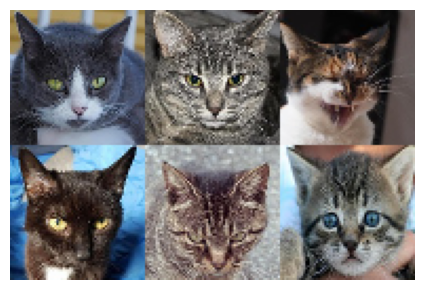

In [5]:
dataset = CatDataset()
visualise(torch.cat([dataset[i].unsqueeze(0) for i in [3, 15, 182, 592, 394, 2941]], dim=0))

### Задание 1 (2 балла)
Для начала реализуем кодировщик для нашего VAE. Предлагается использовать следующую архитектуру:

![](imgs/VAE_enc.png)

Для ее реализации вам потребуются модули `nn.Conv2d`, `nn.ReLU`, `nn.Flatten` и `nn.Linear`.

#### Методы
* `__init__` - принимает на вход `img_size`, `latent_size`, `start_channels` и `downsamplings`. Первый аргумент - высота и ширина картинки в пикселях. Второй аргумент - размерность латентного пространства. `start_channels` отвечает за то, сколько каналов должно быть в картинке перед тем, как к ней будут применены downsampling блоки. `downsamplings` - это количество downsampling блоков, которые должны быть применены к картинке. В каждом таком блоке количество каналов увеличивается в два раза.


* `forward` - принимает на вход батч `x`, возвращает эмбеддинг в латентном пространстве `z` и параметры распределения `(mu, sigma)`.

In [6]:
from task import Encoder

### Задание 2 (3 балла)
Теперь реализуем декодер для VAE. Предлагается использовать следующую архитектуру:

![](imgs/VAE_dec.png)

Для ее реализации вам потребуются модули `nn.Linear`, `nn.Unflatten`, `nn.ConvTranspose2d`, `nn.ReLU` и `nn.Sigmoid`.

#### Методы
* `__init__` - принимает на вход `img_size`, `latent_size`, `end_channels` и `upsamplings`.  Первый аргумент - высота и ширина картинки в пикселях. Второй аргумент - размерность латентного пространства. `end_channels` отвечает за то, сколько каналов должно быть после всех upsampling блоков. `upsamplings` - это количество upsampling блоков, которые должны быть применены к картинке. В каждом таком блоке количество каналов уменьшается в два раза.


* `forward` - принимает на вход `z` - тензор с латентным представлением изображений. Возвращает батч восстановленных изображений.

#### Важно
`Linear Model` в схеме - это полносвязная сеть из нескольких слоев. Предлагается такая архитектура:

`[Linear(c * img_size // 2*N -> 256), ReLU, Linear(256 -> 2 * latent_size)]`

In [7]:
from task import Decoder

### Задание 3 (5 баллов)
Наконец, объединим Encoder и Decoder в Variational Autoencoder.

Полностью архитектура выглядит так:
![](imgs/VAE.png) 

Из нее можно выделить две части: Encoder (по изображению возвращает mu и sigma) и Decoder (по случайному шуму восстанавливает изображение). На высоком уровне VAE можно представить так:

![](imgs/VAE_highlevel.png)

В данном задании вам необходимо реализовать полную архитектуру VAE.

#### Методы
* `__init__` - принимает на вход `img_size`, `downsamplings`, `latent_size`, `linear_hidden_size`, `down_channels` и `up_channels`. `img_size` - размер стороны входного изображения. `downsamplings` - количество downsampling (и upsampling) блоков. `latent_size` - размер латентного пространства, в котором в который будет закодирована картинка. `linear_hidden_size` количество нейронов на скрытом слое полносвязной сети в конце encoder'а. Для полносвязной сети decoder'а это число стоит умножить на 2. `down_channels` - количество каналов, в которое будет преобразовано трехцветное изображение перед применением `downsampling` блоков. `up_channels` - количество каналов, которое должно получиться после применения всех upsampling блоков.

* `forward` - принимает на вход `x`. Считает распределение $N(\mu, \sigma^2)$ и вектор $z \sim N(\mu, \sigma^2)$. Возвращает $x'$ - восстановленную из вектора $z$ картинку и $D_{KL}(N(\mu, \sigma^2), N(0, 1)) = 0.5 \cdot (\sigma^2 + \mu^2 - \log \sigma^2 - 1)$.

* `encode` - принимает на вход `x`. Возвращает вектор из распределения $N(\mu, \sigma^2)$.

* `decode` - принимает на вход `z`. Возвращает восстановленную по вектору картинку.

* `save` - сохраняет чекпоинт обученной модели.

* `load` - загружает сохраненный чекпоинт обученной модели.


#### Если хочется улучшить качество
https://arxiv.org/pdf/1906.00446.pdf

In [8]:
from task import VAE

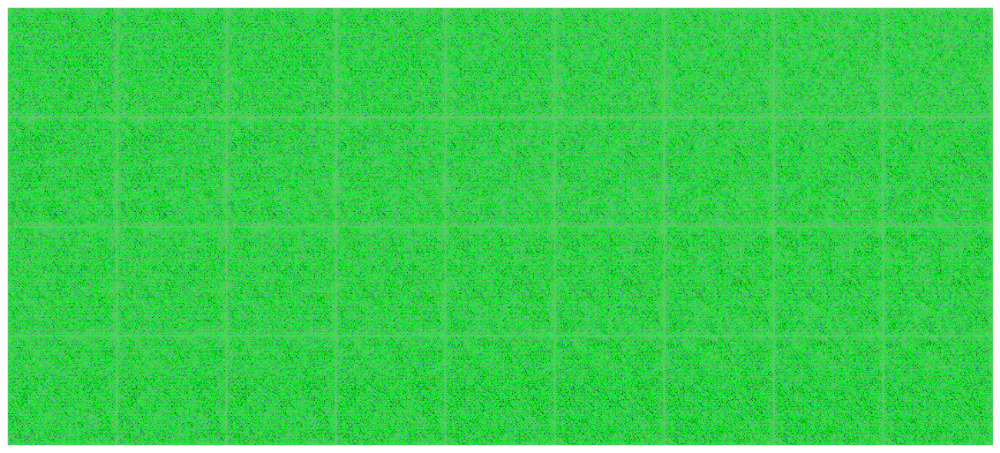

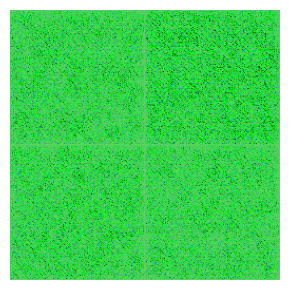

  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 1 | Reconstruction loss: 16894.399647588314 | KLD loss: 1278.2175894346296


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 2 | Reconstruction loss: 10847.73706585428 | KLD loss: 481.5927057680876


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 3 | Reconstruction loss: 8636.95776973748 | KLD loss: 621.5483981778162


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 4 | Reconstruction loss: 7634.339099955115 | KLD loss: 709.3366174164767


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 5 | Reconstruction loss: 6948.764595363451 | KLD loss: 773.78412007397


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 6 | Reconstruction loss: 6377.290073181532 | KLD loss: 835.512017101975


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 7 | Reconstruction loss: 5949.985406911151 | KLD loss: 894.5243647794546


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 8 | Reconstruction loss: 5602.501718461884 | KLD loss: 928.788528631933


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 9 | Reconstruction loss: 5281.690963460792 | KLD loss: 960.8980225746676


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 10 | Reconstruction loss: 5037.717340884002 | KLD loss: 986.1952053093762


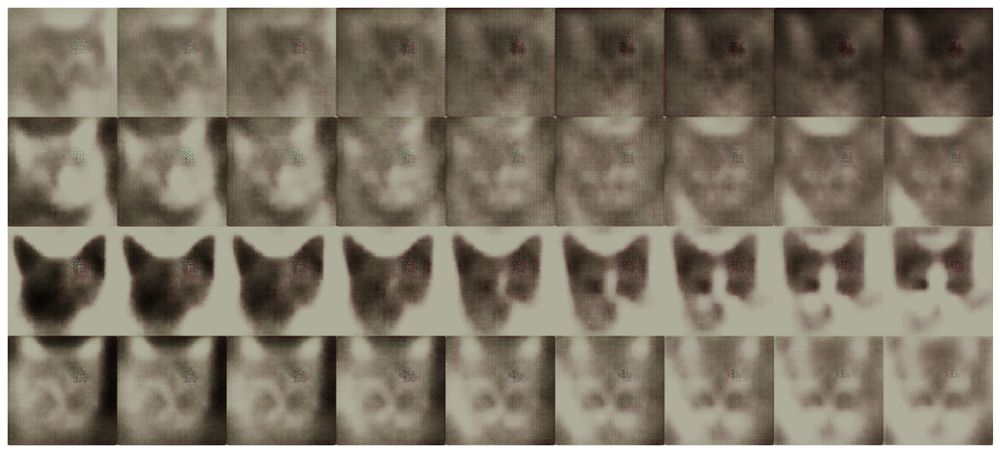

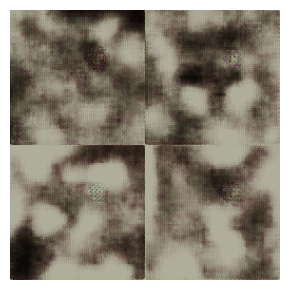

  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 11 | Reconstruction loss: 4846.450079686893 | KLD loss: 1007.6389308005387


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 12 | Reconstruction loss: 4690.998037776591 | KLD loss: 1023.0407494017796


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 13 | Reconstruction loss: 4535.653008692013 | KLD loss: 1028.1606471849525


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 14 | Reconstruction loss: 4450.235423591566 | KLD loss: 1036.956461462175


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 15 | Reconstruction loss: 4358.288206870511 | KLD loss: 1046.184244760075


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 16 | Reconstruction loss: 4239.203617072253 | KLD loss: 1049.9102340603467


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 17 | Reconstruction loss: 4176.495221060995 | KLD loss: 1054.5310782675417


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 18 | Reconstruction loss: 4108.667710203562 | KLD loss: 1063.6995250630823


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 19 | Reconstruction loss: 4030.4374408603453 | KLD loss: 1058.1629993130703


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 20 | Reconstruction loss: 3979.6786464904408 | KLD loss: 1060.61074762759


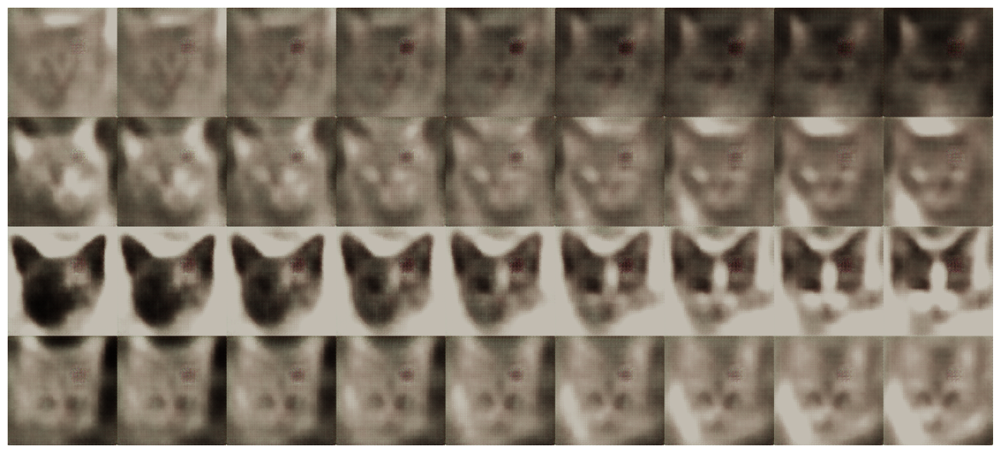

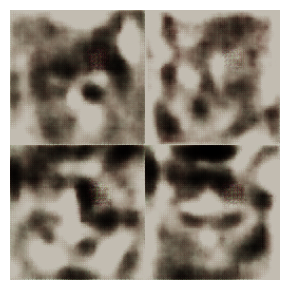

  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 21 | Reconstruction loss: 3931.1544386585306 | KLD loss: 1065.2898853373083


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 22 | Reconstruction loss: 3886.632633185535 | KLD loss: 1061.645628461186


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 23 | Reconstruction loss: 3849.4172116866025 | KLD loss: 1063.9779921821926


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 24 | Reconstruction loss: 3781.7942125782465 | KLD loss: 1068.2033419401748


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 25 | Reconstruction loss: 3753.747440314441 | KLD loss: 1068.7880012085718


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 26 | Reconstruction loss: 3709.116488438956 | KLD loss: 1065.7481214629938


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 27 | Reconstruction loss: 3674.7328165184636 | KLD loss: 1078.6192629796378


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 28 | Reconstruction loss: 3599.147440466081 | KLD loss: 1083.0839917674568


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 29 | Reconstruction loss: 3544.720152671293 | KLD loss: 1083.0869106505968


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 30 | Reconstruction loss: 3489.9670372246214 | KLD loss: 1085.661730558976


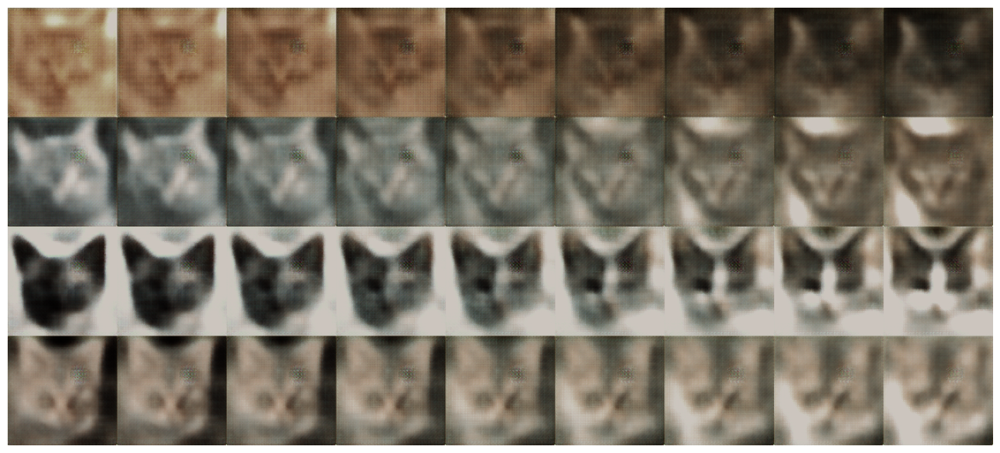

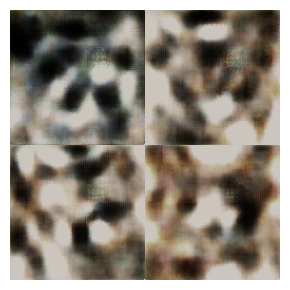

  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 31 | Reconstruction loss: 3475.397548888781 | KLD loss: 1084.2989816606414


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 32 | Reconstruction loss: 3418.7213752699195 | KLD loss: 1079.4237710703974


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 33 | Reconstruction loss: 3398.6525105541537 | KLD loss: 1079.6939545625485


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 34 | Reconstruction loss: 3398.1437374138686 | KLD loss: 1079.3604794140929


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 35 | Reconstruction loss: 3353.2421446616604 | KLD loss: 1074.6613815971043


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 36 | Reconstruction loss: 3329.1704302485687 | KLD loss: 1071.1449296844671


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 37 | Reconstruction loss: 3297.8236218565 | KLD loss: 1069.8876888677942


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 38 | Reconstruction loss: 3280.9597986825506 | KLD loss: 1064.3756316759573


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 39 | Reconstruction loss: 3259.9827516923037 | KLD loss: 1060.993772992436


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 40 | Reconstruction loss: 3262.574943589868 | KLD loss: 1058.9759756526591


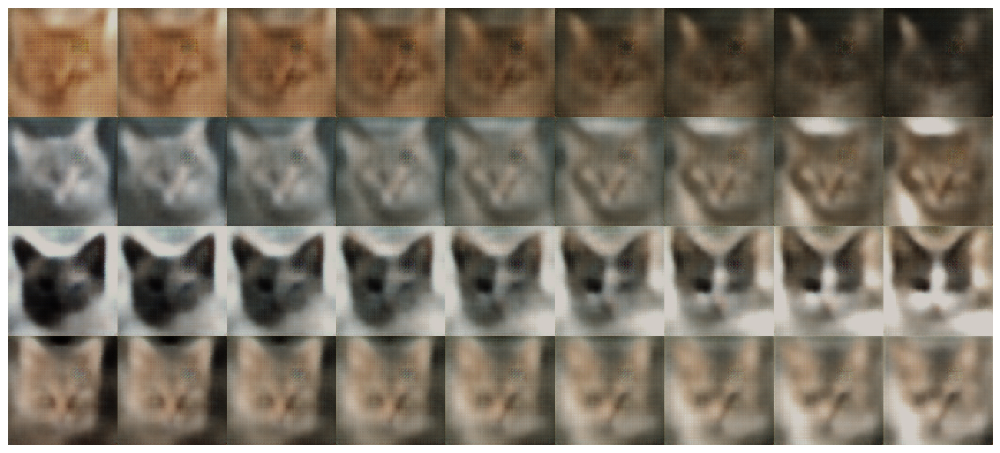

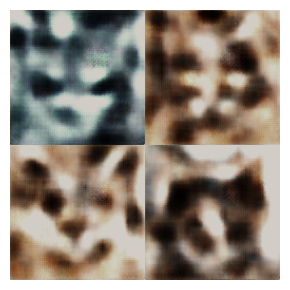

  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 41 | Reconstruction loss: 3230.775736743619 | KLD loss: 1056.840465285023


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 42 | Reconstruction loss: 3207.2801003781906 | KLD loss: 1052.7184226468482


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 43 | Reconstruction loss: 3183.252917935389 | KLD loss: 1049.848010045401


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 44 | Reconstruction loss: 3182.546022024214 | KLD loss: 1049.7320841913638


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 45 | Reconstruction loss: 3167.7597716906057 | KLD loss: 1046.0952835556884


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 46 | Reconstruction loss: 3162.9602651655305 | KLD loss: 1042.553298571095


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 47 | Reconstruction loss: 3142.3022191776254 | KLD loss: 1037.8054474066503


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 48 | Reconstruction loss: 3113.8963113156906 | KLD loss: 1034.5718225514668


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 49 | Reconstruction loss: 3111.854168814902 | KLD loss: 1030.0151904562244


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 50 | Reconstruction loss: 3099.370535335185 | KLD loss: 1031.6157208555233


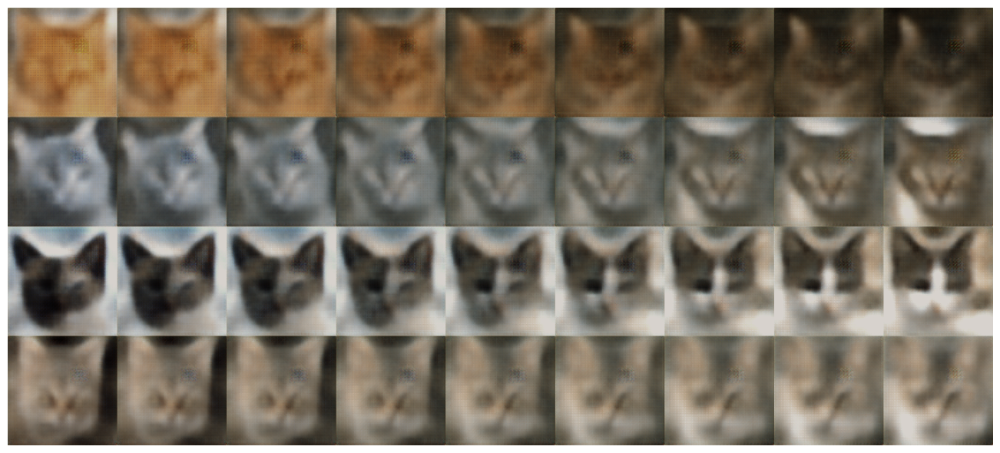

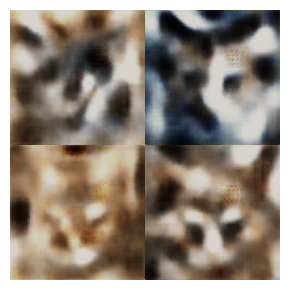

  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 51 | Reconstruction loss: 3089.195522900694 | KLD loss: 1028.7862219010822


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 52 | Reconstruction loss: 3069.5818993230782 | KLD loss: 1027.525112744444


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 53 | Reconstruction loss: 3058.8642481454413 | KLD loss: 1022.6432762382934


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 54 | Reconstruction loss: 3053.7262592197203 | KLD loss: 1020.1289325974743


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 55 | Reconstruction loss: 3045.8888528954167 | KLD loss: 1016.8458524905377


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 56 | Reconstruction loss: 3027.1386931046195 | KLD loss: 1013.9368020762568


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 57 | Reconstruction loss: 3026.4425473420515 | KLD loss: 1012.9611780391717


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 58 | Reconstruction loss: 3016.6902915054225 | KLD loss: 1007.6496469248896


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 59 | Reconstruction loss: 3000.1057244531858 | KLD loss: 1008.0627277445349


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 60 | Reconstruction loss: 2993.389712505459 | KLD loss: 1003.678563372689


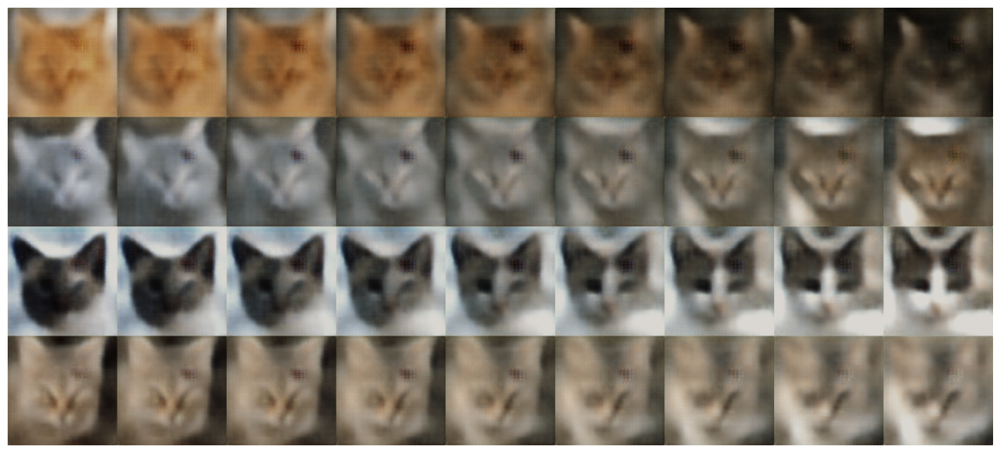

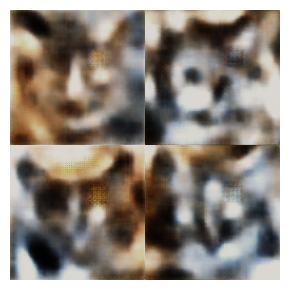

  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 61 | Reconstruction loss: 2977.896742542338 | KLD loss: 1000.8591708544618


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 62 | Reconstruction loss: 2984.067704858247 | KLD loss: 1002.9569675611413


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 63 | Reconstruction loss: 2975.554533206158 | KLD loss: 1000.7463169453307


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 64 | Reconstruction loss: 2964.0531656016474 | KLD loss: 993.3459843226841


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 65 | Reconstruction loss: 2954.6827119625873 | KLD loss: 992.6965753780389


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 66 | Reconstruction loss: 2952.380589076451 | KLD loss: 990.814627795486


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 67 | Reconstruction loss: 2940.5049013884172 | KLD loss: 985.772807056119


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 68 | Reconstruction loss: 2943.669703513199 | KLD loss: 985.2159069369299


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 69 | Reconstruction loss: 2928.0179661342077 | KLD loss: 984.7063462156686


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 70 | Reconstruction loss: 2939.4951166188494 | KLD loss: 986.0168754625024


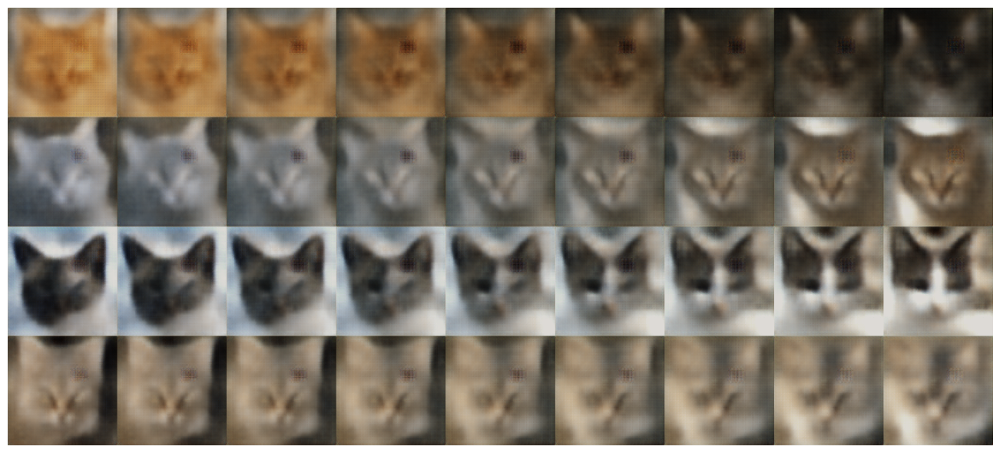

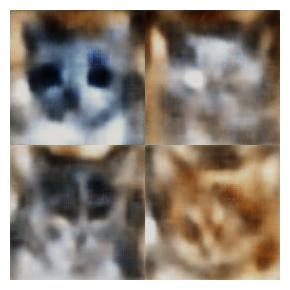

  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 71 | Reconstruction loss: 2931.6820665442424 | KLD loss: 982.2240488751335


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 72 | Reconstruction loss: 2923.6377612759607 | KLD loss: 979.0880628313337


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 73 | Reconstruction loss: 2906.7947541230956 | KLD loss: 973.5297625997792


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 74 | Reconstruction loss: 2909.5093961917096 | KLD loss: 972.9108194860612


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 75 | Reconstruction loss: 2892.334400058533 | KLD loss: 971.7208623471467


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 76 | Reconstruction loss: 2901.9248147336593 | KLD loss: 967.2291148878772


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 77 | Reconstruction loss: 2883.570738798343 | KLD loss: 968.2855296638442


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 78 | Reconstruction loss: 2882.6461297266233 | KLD loss: 966.7341906624551


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 79 | Reconstruction loss: 2887.1418750834023 | KLD loss: 963.8104280270404


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 80 | Reconstruction loss: 2879.7063492484713 | KLD loss: 958.6131755757776


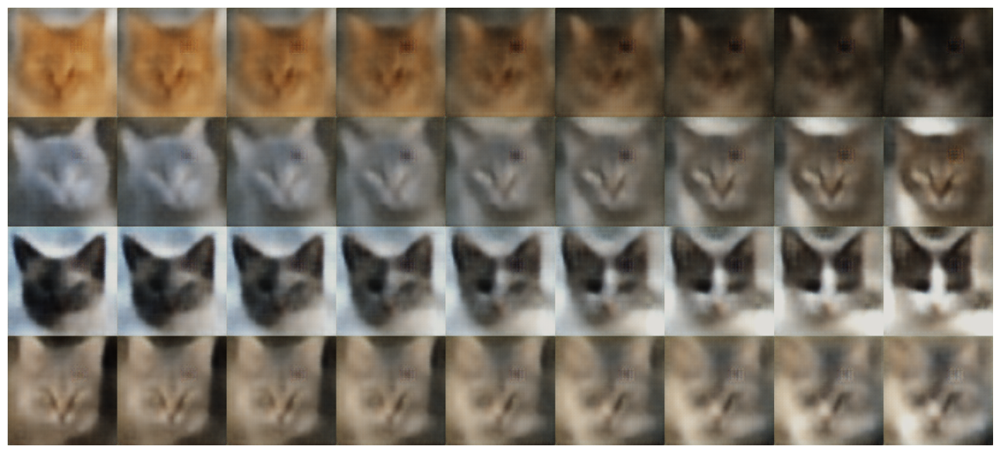

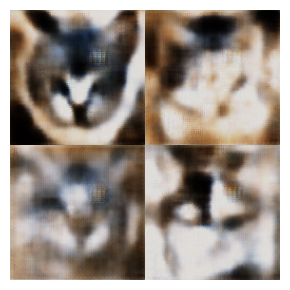

  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 81 | Reconstruction loss: 2873.4895169275887 | KLD loss: 961.0719850907415


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 82 | Reconstruction loss: 2879.5306426812404 | KLD loss: 958.8762509363779


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 83 | Reconstruction loss: 2869.2587953176558 | KLD loss: 951.563873764891


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 84 | Reconstruction loss: 2867.365122729947 | KLD loss: 953.3136324675187


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 85 | Reconstruction loss: 2857.005890461229 | KLD loss: 950.8680934550599


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 86 | Reconstruction loss: 2856.3500123586714 | KLD loss: 949.9903538863852


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 87 | Reconstruction loss: 2855.1499677385605 | KLD loss: 944.7072667660921


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 88 | Reconstruction loss: 2852.3950492906274 | KLD loss: 944.441902113257


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 89 | Reconstruction loss: 2849.0515652295226 | KLD loss: 942.466149087278


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 90 | Reconstruction loss: 2838.382813447751 | KLD loss: 940.0334170323721


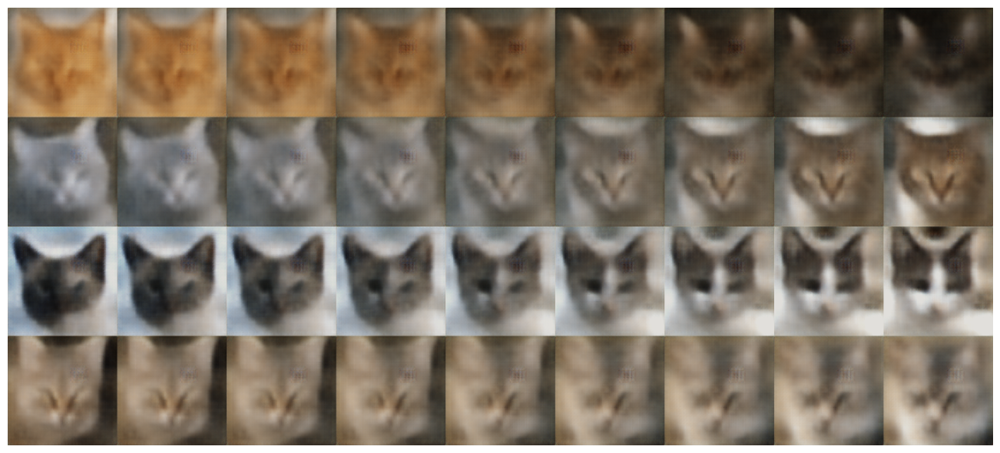

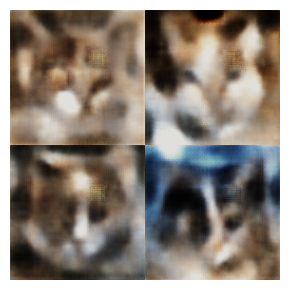

  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 91 | Reconstruction loss: 2850.5523799161733 | KLD loss: 940.0904884101441


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 92 | Reconstruction loss: 2832.8008826593436 | KLD loss: 937.4180123465402


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 93 | Reconstruction loss: 2831.1860704125825 | KLD loss: 934.8380770475968


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 94 | Reconstruction loss: 2837.9753889948684 | KLD loss: 931.7791772688398


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 95 | Reconstruction loss: 2836.0670505310436 | KLD loss: 930.1680695906929


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 96 | Reconstruction loss: 2829.7949286988064 | KLD loss: 926.4435203978734


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 97 | Reconstruction loss: 2818.4485278396132 | KLD loss: 928.0505140790287


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 98 | Reconstruction loss: 2816.2490350000608 | KLD loss: 924.8655936673562


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 99 | Reconstruction loss: 2825.6513677561506 | KLD loss: 926.8121520806544


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 100 | Reconstruction loss: 2816.4989654351466 | KLD loss: 922.6666303362165


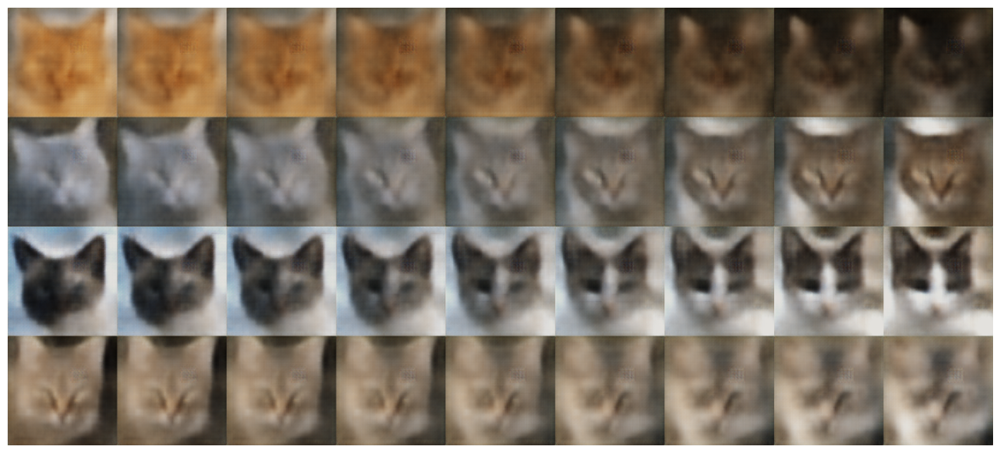

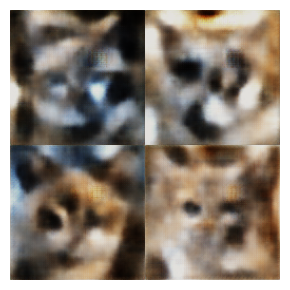

  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 101 | Reconstruction loss: 2812.14300139054 | KLD loss: 920.9518563406808


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 102 | Reconstruction loss: 2810.2024170300974 | KLD loss: 920.2137458753882


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 103 | Reconstruction loss: 2805.860059655231 | KLD loss: 914.4864481102605


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 104 | Reconstruction loss: 2808.634535700638 | KLD loss: 916.3034486948333


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 105 | Reconstruction loss: 2801.0120881832904 | KLD loss: 912.9297836967137


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 106 | Reconstruction loss: 2800.059739580806 | KLD loss: 912.4039239350313


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 107 | Reconstruction loss: 2799.2248131414376 | KLD loss: 909.6255495059564


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 108 | Reconstruction loss: 2793.970267728249 | KLD loss: 906.0453951817861


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 109 | Reconstruction loss: 2789.884336104304 | KLD loss: 905.185412294376


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 110 | Reconstruction loss: 2793.995207223833 | KLD loss: 903.4003057065217


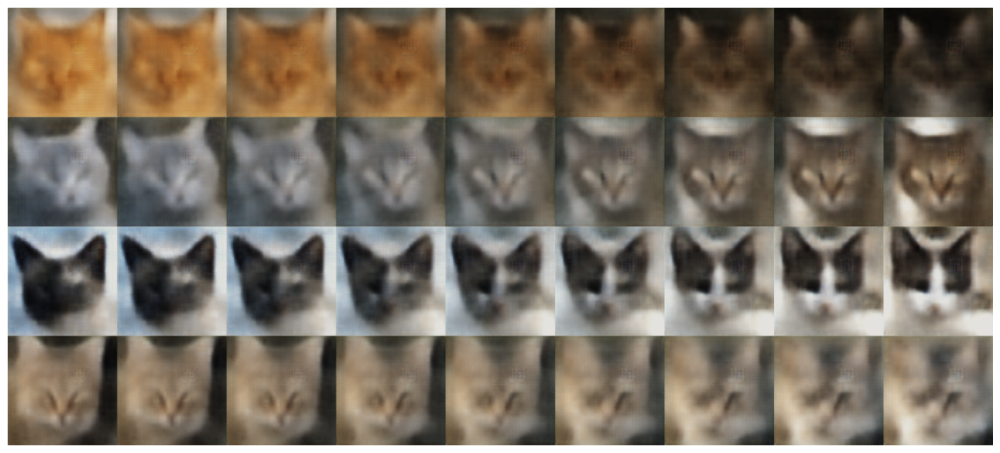

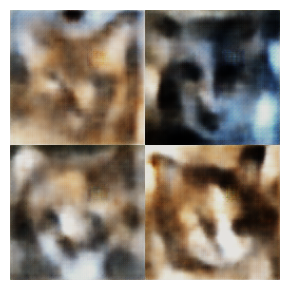

  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 111 | Reconstruction loss: 2790.4853142211155 | KLD loss: 900.5334554162825


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 112 | Reconstruction loss: 2779.391571234472 | KLD loss: 900.1028044327446


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 113 | Reconstruction loss: 2774.6857036329943 | KLD loss: 897.7853545194828


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 114 | Reconstruction loss: 2781.4378658318374 | KLD loss: 893.7254068125849


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 115 | Reconstruction loss: 2773.069105634038 | KLD loss: 893.1260932306325


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 116 | Reconstruction loss: 2771.987034768051 | KLD loss: 893.2690853332141


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 117 | Reconstruction loss: 2773.467319085731 | KLD loss: 889.2710049078331


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 118 | Reconstruction loss: 2776.6601717931144 | KLD loss: 890.0960354064563


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 119 | Reconstruction loss: 2766.2061875621725 | KLD loss: 889.2923569768112


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 120 | Reconstruction loss: 2764.7549711428815 | KLD loss: 886.7313312980699


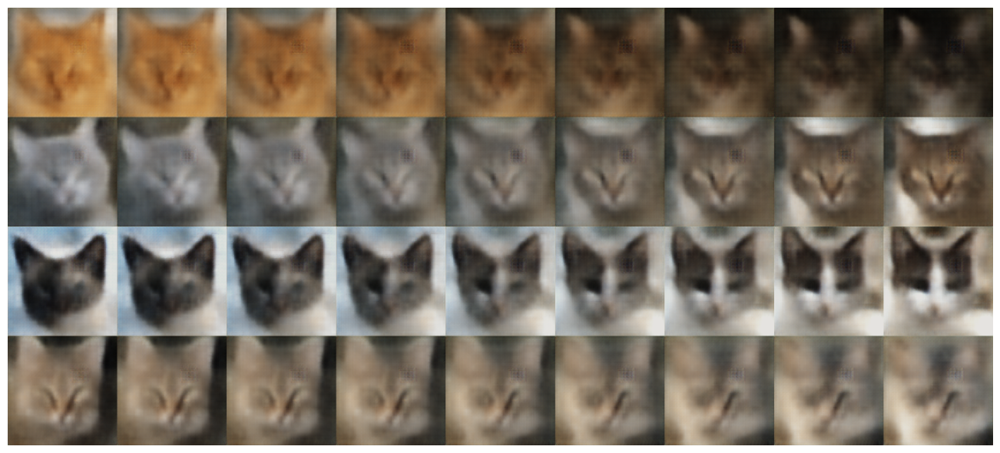

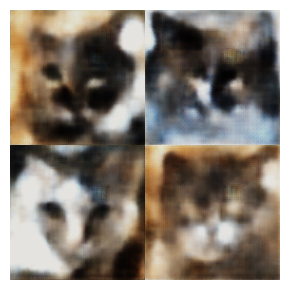

  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 121 | Reconstruction loss: 2769.835928970242 | KLD loss: 882.0316236981694


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 122 | Reconstruction loss: 2763.5902914675125 | KLD loss: 882.6424315079399


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 123 | Reconstruction loss: 2763.128778303632 | KLD loss: 879.0168177444742


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 124 | Reconstruction loss: 2758.776179532827 | KLD loss: 879.9048022157657


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 125 | Reconstruction loss: 2756.11539738815 | KLD loss: 874.9868836017869


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 126 | Reconstruction loss: 2753.2664556088653 | KLD loss: 876.8287079615623


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 127 | Reconstruction loss: 2756.387459891183 | KLD loss: 875.1804968792459


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 128 | Reconstruction loss: 2752.1949819244956 | KLD loss: 875.5850060504416


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 129 | Reconstruction loss: 2746.0447738363137 | KLD loss: 870.3910114928062


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 130 | Reconstruction loss: 2748.135055068117 | KLD loss: 870.6256498727739


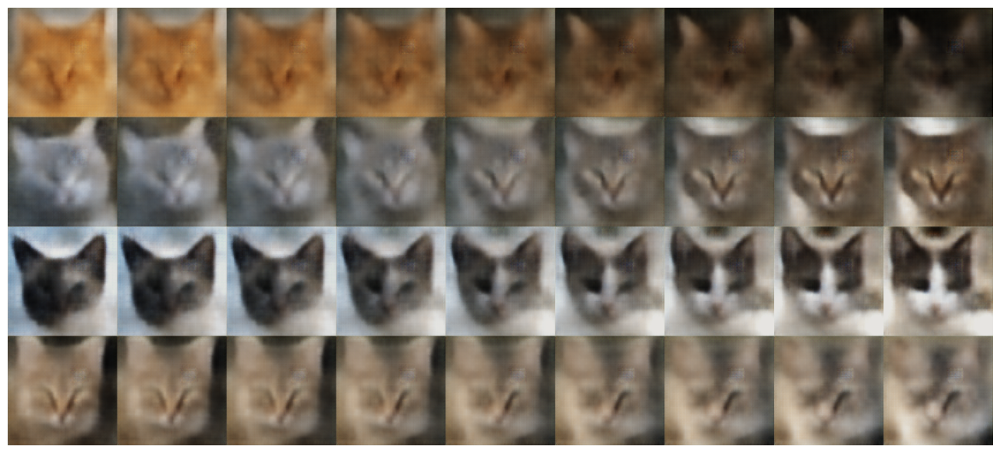

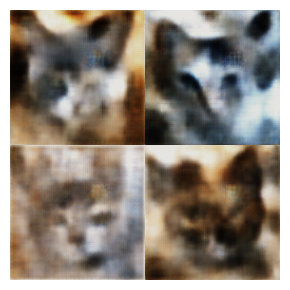

  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 131 | Reconstruction loss: 2743.5166201384172 | KLD loss: 866.7443645785314


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 132 | Reconstruction loss: 2740.8309153681216 | KLD loss: 866.1885710532621


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 133 | Reconstruction loss: 2742.3563276018417 | KLD loss: 864.8501315857312


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 134 | Reconstruction loss: 2740.7058681701283 | KLD loss: 865.8378378352763


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 135 | Reconstruction loss: 2742.765962209761 | KLD loss: 862.9269431925709


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 136 | Reconstruction loss: 2736.5988225522246 | KLD loss: 858.658800966251


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 137 | Reconstruction loss: 2733.703395298549 | KLD loss: 862.2016731404369


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 138 | Reconstruction loss: 2740.136117496846 | KLD loss: 857.5860420369213


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 139 | Reconstruction loss: 2725.6414590207687 | KLD loss: 854.2298537544582


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 140 | Reconstruction loss: 2730.6561538980613 | KLD loss: 853.1026042677601


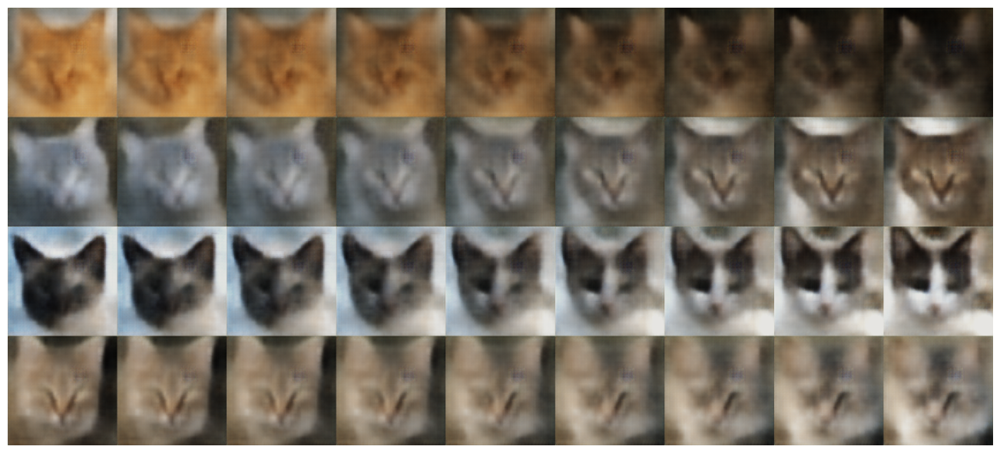

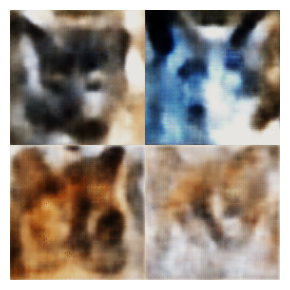

  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 141 | Reconstruction loss: 2728.3499789978405 | KLD loss: 852.4076385498047


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 142 | Reconstruction loss: 2725.6880874159915 | KLD loss: 850.949237136367


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 143 | Reconstruction loss: 2725.5919959026833 | KLD loss: 850.2530018113415


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 144 | Reconstruction loss: 2720.547694425405 | KLD loss: 848.0412666842063


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 145 | Reconstruction loss: 2713.776248908191 | KLD loss: 845.8196198836616


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 146 | Reconstruction loss: 2718.750557846164 | KLD loss: 844.3718855958548


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 147 | Reconstruction loss: 2719.1667916434153 | KLD loss: 844.3184887429942


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 148 | Reconstruction loss: 2714.446111833087 | KLD loss: 844.3961973012605


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 149 | Reconstruction loss: 2715.5202172320824 | KLD loss: 839.2151205880301


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 150 | Reconstruction loss: 2708.568275593823 | KLD loss: 838.5419225278108


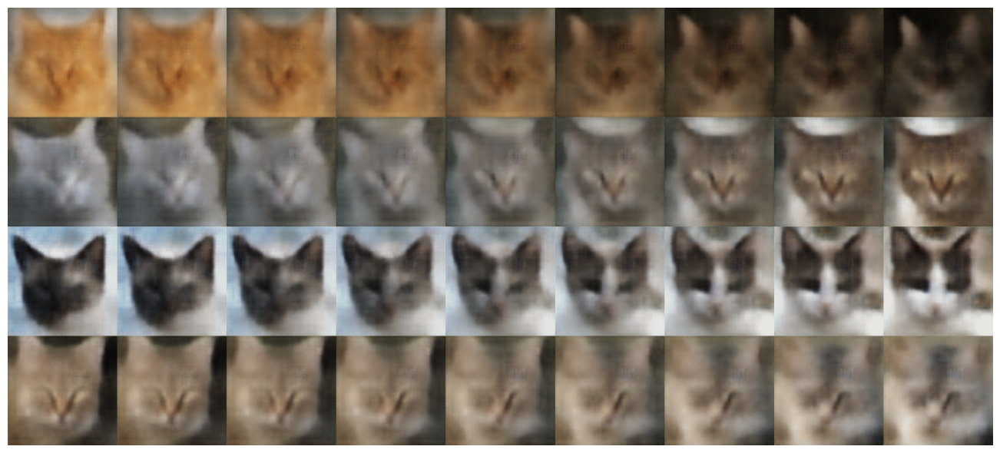

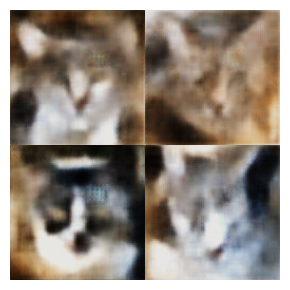

  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 151 | Reconstruction loss: 2710.605516516644 | KLD loss: 839.7685299512023


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 152 | Reconstruction loss: 2705.7895543827035 | KLD loss: 835.4365904434868


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 153 | Reconstruction loss: 2707.1605533576158 | KLD loss: 834.6787053457698


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 154 | Reconstruction loss: 2703.7076675699363 | KLD loss: 833.281752307963


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 155 | Reconstruction loss: 2697.808723023219 | KLD loss: 828.482130062506


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 156 | Reconstruction loss: 2706.5509998013513 | KLD loss: 830.4848504866133


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 157 | Reconstruction loss: 2700.6871508485783 | KLD loss: 827.1902599453185


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 158 | Reconstruction loss: 2698.2274281756477 | KLD loss: 828.4620339529855


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 159 | Reconstruction loss: 2695.0502781838363 | KLD loss: 824.4340996594162


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 160 | Reconstruction loss: 2691.282574766171 | KLD loss: 823.1364013482325


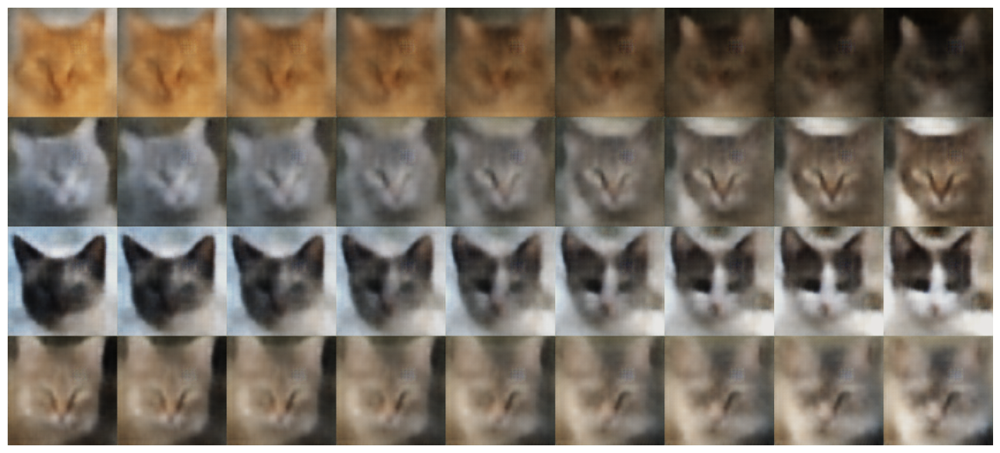

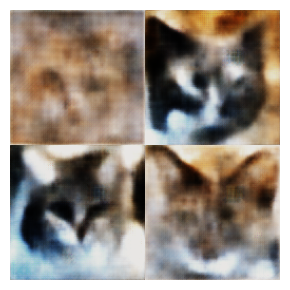

  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 161 | Reconstruction loss: 2694.5036302649455 | KLD loss: 823.9238506814708


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 162 | Reconstruction loss: 2692.198497322035 | KLD loss: 821.5298298900913


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 163 | Reconstruction loss: 2692.21915146727 | KLD loss: 821.4678258481233


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 164 | Reconstruction loss: 2692.225468605942 | KLD loss: 821.3575139016098


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 165 | Reconstruction loss: 2690.9175236861897 | KLD loss: 815.5914060225398


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 166 | Reconstruction loss: 2684.2332460391594 | KLD loss: 812.8394026667435


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 167 | Reconstruction loss: 2679.8639590814246 | KLD loss: 811.9995459325565


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 168 | Reconstruction loss: 2681.948887605845 | KLD loss: 811.8003472748751


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 169 | Reconstruction loss: 2682.1341899611193 | KLD loss: 813.3678422063034


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 170 | Reconstruction loss: 2679.277100746676 | KLD loss: 811.8214867633322


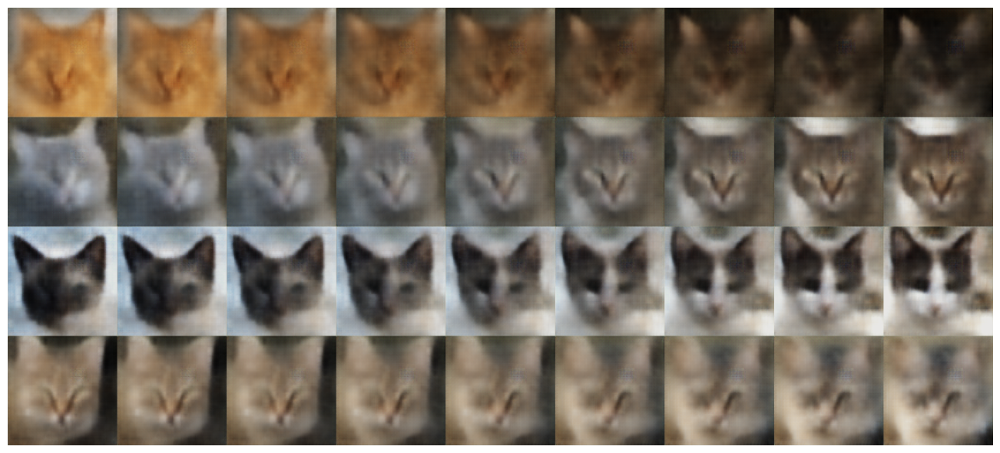

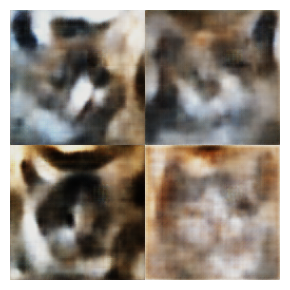

  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 171 | Reconstruction loss: 2678.4673738657316 | KLD loss: 807.812671448133


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 172 | Reconstruction loss: 2669.8690911524045 | KLD loss: 806.8147212437221


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 173 | Reconstruction loss: 2675.6653518202884 | KLD loss: 805.8333980015346


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 174 | Reconstruction loss: 2676.90251756751 | KLD loss: 803.6837222650184


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 175 | Reconstruction loss: 2667.74893681307 | KLD loss: 803.401254310371


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 176 | Reconstruction loss: 2673.3885153065557 | KLD loss: 801.6809230828137


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 177 | Reconstruction loss: 2663.340187783567 | KLD loss: 799.4125841034125


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 178 | Reconstruction loss: 2671.215508692013 | KLD loss: 799.3129753918381


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 179 | Reconstruction loss: 2665.7947802810195 | KLD loss: 800.8584001434516


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 180 | Reconstruction loss: 2673.7007893627474 | KLD loss: 796.918220472632


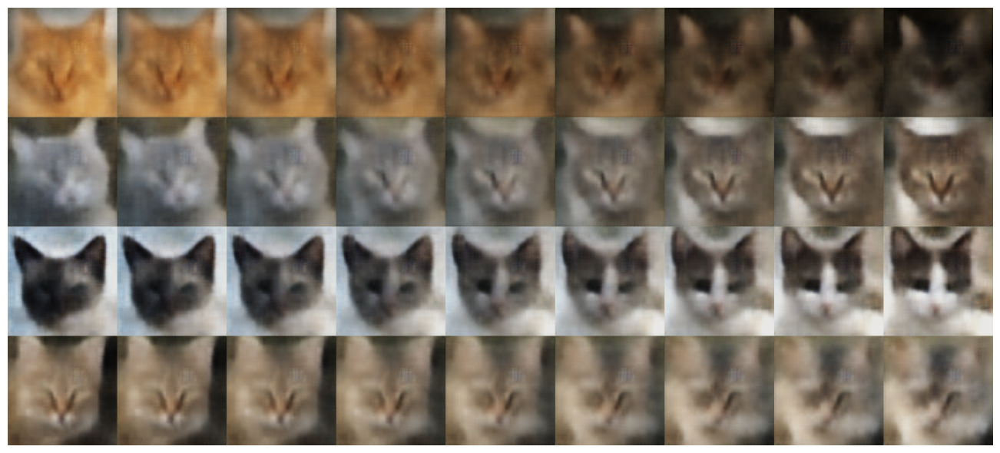

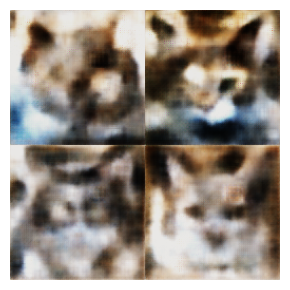

  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 181 | Reconstruction loss: 2661.184642910217 | KLD loss: 795.1270113169036


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 182 | Reconstruction loss: 2660.156847841251 | KLD loss: 795.672645426685


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 183 | Reconstruction loss: 2658.102238815023 | KLD loss: 795.4188765057866


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 184 | Reconstruction loss: 2659.5800182271446 | KLD loss: 791.1070021161381


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 185 | Reconstruction loss: 2657.0045810486217 | KLD loss: 789.2275618085209


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 186 | Reconstruction loss: 2657.9759424813788 | KLD loss: 789.7233195808363


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 187 | Reconstruction loss: 2655.8888386791537 | KLD loss: 789.8816724504743


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 188 | Reconstruction loss: 2655.957457927443 | KLD loss: 787.964535636191


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 189 | Reconstruction loss: 2647.4337751495173 | KLD loss: 785.6471661869783


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 190 | Reconstruction loss: 2653.105895427443 | KLD loss: 784.1197790299883


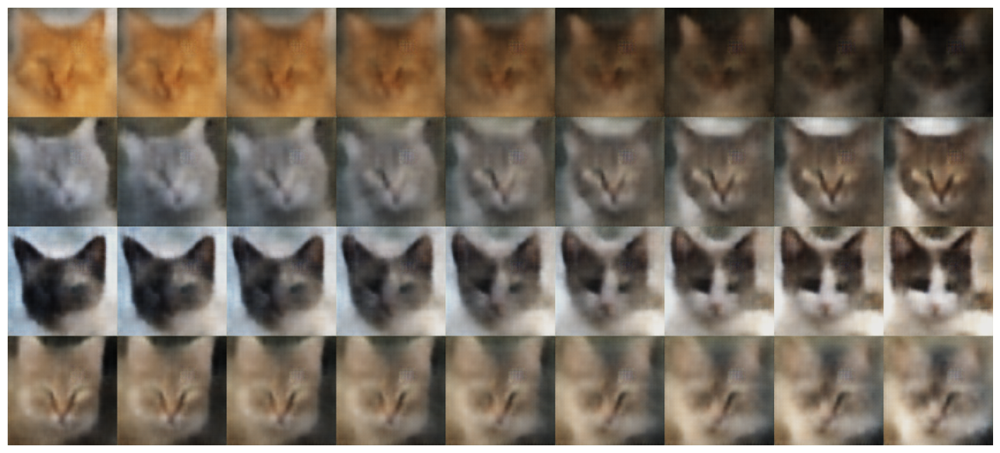

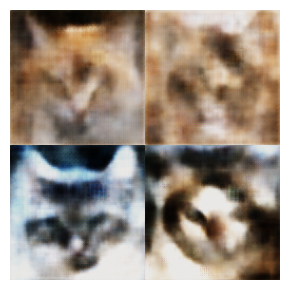

  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 191 | Reconstruction loss: 2650.237839598093 | KLD loss: 783.8371770633673


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 192 | Reconstruction loss: 2645.622531488075 | KLD loss: 783.6282639592331


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 193 | Reconstruction loss: 2645.440688233938 | KLD loss: 782.6033620893585


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 194 | Reconstruction loss: 2641.87621539572 | KLD loss: 780.0089481898716


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 195 | Reconstruction loss: 2645.4543549910836 | KLD loss: 778.5405399488366


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 196 | Reconstruction loss: 2637.4672912218557 | KLD loss: 777.7474303630569


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 197 | Reconstruction loss: 2641.7169970399846 | KLD loss: 776.8865576323515


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 198 | Reconstruction loss: 2641.1451309867525 | KLD loss: 777.222394670759


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 199 | Reconstruction loss: 2635.946379098833 | KLD loss: 775.0178356289123


  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 200 | Reconstruction loss: 2628.951325789742 | KLD loss: 774.0197013712818


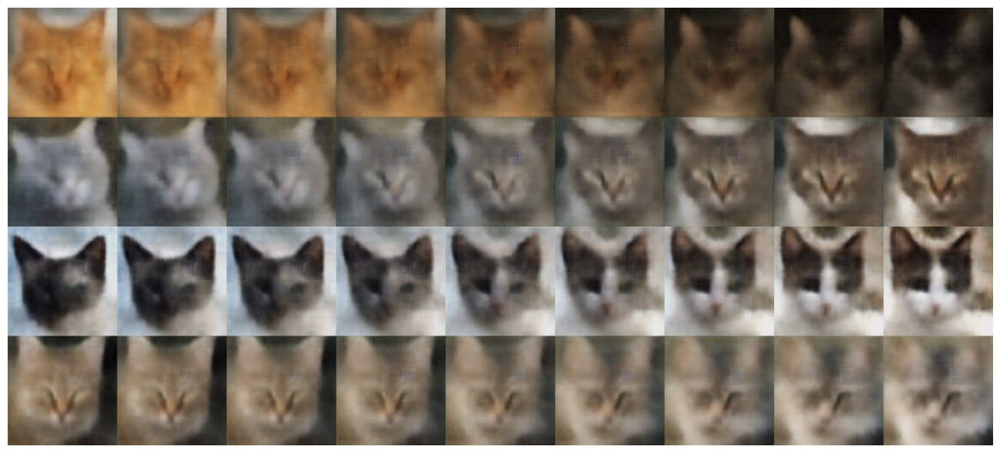

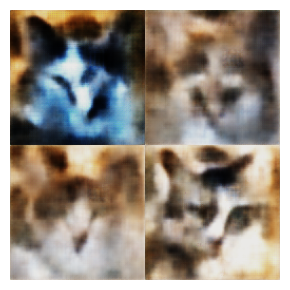

  0%|          | 0/645 [00:00<?, ?it/s]

Epoch 201 | Reconstruction loss: 2630.793570950905 | KLD loss: 770.4409757815533


In [9]:
def train_vae():
    vae = VAE()
    vae.cuda()

    epochs = 201
    batch_size = 8
    vae_optim = Adam(vae.parameters(), lr=1e-4)

    dataset = CatDataset(size=128)

    test_imgs_1 = torch.cat([dataset[i].unsqueeze(0) for i in (0, 34, 76, 1509)])
    test_imgs_2 = torch.cat([dataset[i].unsqueeze(0) for i in (734, 123, 512, 3634)])

    for ep in range(epochs):
        dataloader = DataLoader(dataset, shuffle=True, batch_size=batch_size)
        total_batches = 0
        rec_loss_avg = 0
        kld_loss_avg = 0

        if ep % 10 == 0:
            with torch.no_grad():
                z_1 = vae.encode(test_imgs_1.cuda())
                z_2 = vae.encode(test_imgs_2.cuda())
                x_int = []
                for i in range(9):
                    z = (i * z_1 + (8 - i) * z_2) / 8
                    x_int.append(vae.decode(z))
                x_int = torch.cat(x_int)
                visualise(x_int, rows=len(test_imgs_1))
                z_rand = torch.randn_like(z_1)
                x_int = vae.decode(z_rand)
                visualise(x_int, rows=len(test_imgs_1)//2)

        for i, batch in tqdm(enumerate(dataloader), total=(len(dataset) + batch_size) // batch_size):
            if len(batch) < batch_size:
                continue
            total_batches += 1
            x = batch.cuda()
            x_rec, kld = vae(x)
            img_elems = float(np.prod(list(batch.size())))
            kld_loss = kld.sum() / batch_size
            rec_loss = ((x_rec - x)**2).sum() / batch_size
            loss = rec_loss + 0.1 * kld_loss # https://openreview.net/forum?id=Sy2fzU9gl
            vae_optim.zero_grad()
            loss.backward()
            vae_optim.step()
            kld_loss_avg += kld_loss.item()
            rec_loss_avg += rec_loss.item()

        print(f"Epoch {ep+1} | Reconstruction loss: {rec_loss_avg / total_batches} | KLD loss: {kld_loss_avg / total_batches}")
    vae.save()

train_vae()